In [1]:
import torch
torch.cuda.is_available()

True

In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import torch.nn.functional as F

In [2]:
# Add Windows-specific memory sharing strategy
if os.name == 'nt':  # Check if running on Windows
    import torch.multiprocessing
    torch.multiprocessing.set_sharing_strategy('file_system')
    print("Set Windows file system sharing strategy for DataLoader")

Set Windows file system sharing strategy for DataLoader


In [3]:
# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [4]:
# Root directory for dataset
dataroot = 'Data/dataset'

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 256

# Spatial size of training images. All images will be resized to this
# size using a transformer.
image_size = 128

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Weight between various components of total generator loss
weightRecon = 0.99

# Number of training epochs
num_epochs = 100

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

cuda


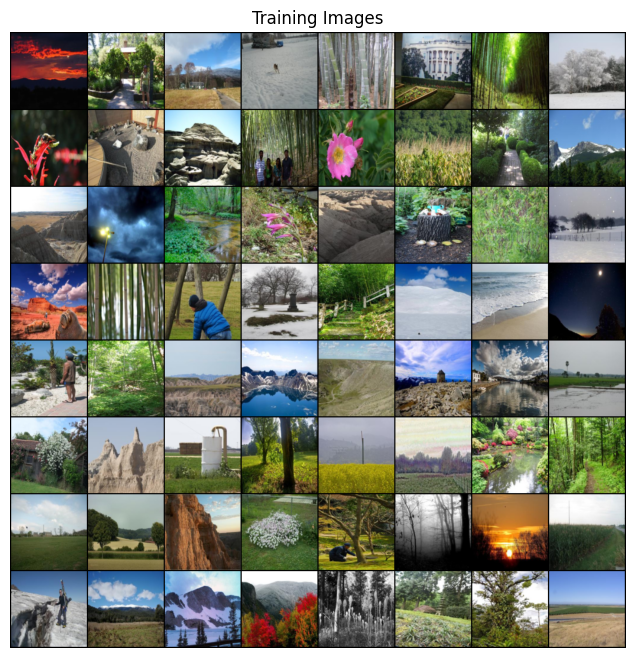

In [5]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

# Try other datasets below:

# dataset = dset.MNIST(root=dataroot, train=True, transform=transforms.Compose([
#                                transforms.Resize(image_size),
#                                transforms.CenterCrop(image_size),
#                                transforms.ToTensor(),
#                                transforms.Normalize((0.5), (0.5)),
#                            ]), download=True)
# nc = 1

# dataset = dset.Places365(root=dataroot, split='train-standard', small=True, transform=transforms.Compose([
#                                transforms.Resize(image_size),
#                                transforms.CenterCrop(image_size),
#                                transforms.ToTensor(),
#                                transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
#                            ]), download=True)


# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers, 
                                         pin_memory=False,  # Disable pinned memory
                                         persistent_workers=False  # Don't keep workers alive between iterations
    )

# Decide which device we want to run on
device = torch.device("cuda" if (torch.cuda.is_available() and ngpu > 0) else "cpu")
print(device)
# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [6]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [7]:
class ImprovedGenerator(nn.Module):
    def __init__(self, ngpu):
        super(ImprovedGenerator, self).__init__()
        self.ngpu = ngpu
        
        # Encoder layers
        self.enc1 = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True)
        )
        
        self.enc2 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True)
        )
        
        self.enc3 = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True)
        )
        
        self.enc4 = nn.Sequential(
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True)
        )
        
        self.enc5 = nn.Sequential(
            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True)
        )
        
        # Bottleneck
        self.bottleneck = nn.Sequential(
            nn.Conv2d(512, 2048, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(2048),
            nn.LeakyReLU(0.2, inplace=True)
        )
        
        # Decoder with skip connections
        self.dec1 = nn.Sequential(
            nn.ConvTranspose2d(2048, 512, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            nn.Dropout(0.2)  # Add dropout for regularization
        )
        
        self.dec2 = nn.Sequential(
            nn.ConvTranspose2d(512 + 512, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True)
        )
        
        self.dec3 = nn.Sequential(
            nn.ConvTranspose2d(256 + 256, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True)
        )
        
        self.dec4 = nn.Sequential(
            nn.ConvTranspose2d(128 + 128, 64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True)
        )
        
        self.dec5 = nn.Sequential(
            nn.ConvTranspose2d(64 + 64, 3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )
        
    def forward(self, x):
        # Encoder
        e1 = self.enc1(x)
        e2 = self.enc2(e1)
        e3 = self.enc3(e2)
        e4 = self.enc4(e3)
        e5 = self.enc5(e4)
        
        # Bottleneck
        b = self.bottleneck(e5)
        
        # Decoder with skip connections
        d1 = self.dec1(b)
        d2 = self.dec2(torch.cat([d1, e5], 1))
        d3 = self.dec3(torch.cat([d2, e4], 1))
        d4 = self.dec4(torch.cat([d3, e3], 1))
        output = self.dec5(torch.cat([d4, e2], 1))
        
        return output

In [8]:
# Create the generator
netG = ImprovedGenerator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
# to mean=0, stdev=0.02.
netG.apply(weights_init)

# Print the model
print(netG)

ImprovedGenerator(
  (enc1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (enc2): Sequential(
    (0): Conv2d(64, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (enc3): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (enc4): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (enc5): Sequential(
    (0): Conv2d(256, 512

In [9]:
# Self-attention module for the discriminator
class SelfAttention(nn.Module):
    def __init__(self, in_dim):
        super(SelfAttention, self).__init__()
        self.query_conv = nn.Conv2d(in_dim, in_dim//8, 1)
        self.key_conv = nn.Conv2d(in_dim, in_dim//8, 1)
        self.value_conv = nn.Conv2d(in_dim, in_dim, 1)
        self.gamma = nn.Parameter(torch.zeros(1))
        
        self.softmax = nn.Softmax(dim=-1)
        
    def forward(self, x):
        batch_size, C, width, height = x.size()
        
        # Create queries, keys, and values
        proj_query = self.query_conv(x).view(batch_size, -1, width*height).permute(0, 2, 1)
        proj_key = self.key_conv(x).view(batch_size, -1, width*height)
        energy = torch.bmm(proj_query, proj_key)
        
        # Create attention map
        attention = self.softmax(energy)
        
        # Apply attention to values
        proj_value = self.value_conv(x).view(batch_size, -1, width*height)
        out = torch.bmm(proj_value, attention.permute(0, 2, 1))
        out = out.view(batch_size, C, width, height)
        
        # Residual connection weighted by learnable parameter gamma
        out = self.gamma * out + x
        
        return out

In [10]:
class ImprovedDiscriminator(nn.Module):
    def __init__(self, ngpu):
        super(ImprovedDiscriminator, self).__init__()
        self.ngpu = ngpu
        
        # First layer - no BatchNorm here
        self.layer1 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True)
        )
        
        # Second layer
        self.layer2 = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout2d(0.25)  # Add dropout for regularization
        )
        
        # Self-attention layer after second conv - helps focus on important regions
        self.attention = SelfAttention(128)
        
        # Third layer
        self.layer3 = nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True)
        )
        
        # Fourth layer
        self.layer4 = nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True)
        )
        
        # Final classification layer
        self.layer5 = nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, bias=False)
        
        # Sigmoid for standard GAN (comment out for Wasserstein GAN)
        self.sigmoid = nn.Sigmoid()
        
    def forward(self, x):
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.attention(x)  # Apply self-attention
        x = self.layer3(x)
        x = self.layer4(x)
        x = self.layer5(x)
        return self.sigmoid(x)

In [11]:
# Create the Discriminator
netD = ImprovedDiscriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
# to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

ImprovedDiscriminator(
  (layer1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (layer2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): Dropout2d(p=0.25, inplace=False)
  )
  (attention): SelfAttention(
    (query_conv): Conv2d(128, 16, kernel_size=(1, 1), stride=(1, 1))
    (key_conv): Conv2d(128, 16, kernel_size=(1, 1), stride=(1, 1))
    (value_conv): Conv2d(128, 128, kernel_size=(1, 1), stride=(1, 1))
    (softmax): Softmax(dim=-1)
  )
  (layer3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0

In [12]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
# the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [13]:
def get_random_block_mask(samples: torch.Tensor, min_size: int = 32, max_size: int = 64):
    B, C, H, W = samples.size()
    # Clone images to apply the mask
    masked_samples = samples.clone()
    
    # Save mask information
    mask_info = []  # To save [top, left, mask_h, mask_w] for each image
    
    for i in range(B):
        # Choose random size for mask
        mask_h = random.randint(min_size, min(max_size, H))
        mask_w = random.randint(min_size, min(max_size, W))
        
        # Random top-left corner of the mask, ensuring it stays within image bounds
        top = random.randint(0, H - mask_h)
        left = random.randint(0, W - mask_w)
        
        # Fill mask area with normalized mean RGB values
        masked_samples[i, 0, top:top+mask_h, left:left+mask_w] = (2 * 117.0 / 255.0 - 1.0)
        masked_samples[i, 1, top:top+mask_h, left:left+mask_w] = (2 * 104.0 / 255.0 - 1.0)
        masked_samples[i, 2, top:top+mask_h, left:left+mask_w] = (2 * 123.0 / 255.0 - 1.0)
        
        # Save mask information
        mask_info.append((top, left, mask_h, mask_w))
    
    # Create list of masked parts to return
    true_masked_parts = []
    for i, (top, left, mask_h, mask_w) in enumerate(mask_info):
        true_part = samples[i, :, top:top+mask_h, left:left+mask_w]
        # Resize to 64x64 for the generator output
        true_part_resized = F.interpolate(true_part.unsqueeze(0), size=(64, 64), mode='bilinear', align_corners=False).squeeze(0)
        true_masked_parts.append(true_part_resized)
    
    return masked_samples, torch.stack(true_masked_parts), mask_info

In [14]:
def get_weights(prediction_size: torch.Size):
    loss_weights = torch.ones(prediction_size)
    return loss_weights

def weighted_mse_loss(outputs, targets, weights):
    return torch.mean(weights * (outputs - targets).pow(2))

In [15]:
# For training visualization purposes
viz_masked_samples, viz_true_masked_part, viz_mask_info = get_random_block_mask(real_batch[0].to(device))

In [16]:
import gc

In [18]:
# Training Loop
# Lists to keep track of progress
img_list = []
G_losses = []
G_mse_losses = []
G_Tot_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        gc.collect()  # Explicitly run garbage collection between epochs
        torch.cuda.empty_cache()  # Clear CUDA cache if using GPU
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        
        masked_samples, true_masked_tensor, mask_info = get_random_block_mask(real_cpu)
        
        # Forward pass real batch through D
        output = netD(true_masked_tensor).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()
        
        ## Train with all-fake batch
        # Generate fake image batch with G
        fake = netG(masked_samples)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()
        
        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        D_G_z2 = output.mean().item()
        
        # Add MSE loss between generated infill and original
        l2_weights = get_weights(fake.size())
        lossGeneratorRecon = weighted_mse_loss(fake, true_masked_tensor, l2_weights.to(device))
        lossGeneratorTotal = (1 - weightRecon) * errG + weightRecon * lossGeneratorRecon
        
        lossGeneratorTotal.backward()
        optimizerG.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
            
            # Save Losses for plotting later
            G_losses.append(errG.item())
            G_mse_losses.append(lossGeneratorRecon.item())
            G_Tot_losses.append(lossGeneratorTotal.item())
            D_losses.append(errD.item())
        
        
        # Check how the generator is doing by saving G's output on fixed examples
        if (iters % 50 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(viz_masked_samples).detach()
                viz_infill = viz_masked_samples.clone()
                
                # Correctly apply the generated content to the masked areas
                # We need to resize the 64x64 outputs to match the original mask sizes
                for idx, (top, left, mask_h, mask_w) in enumerate(viz_mask_info):
                    if idx < fake.size(0):  # Make sure we don't exceed batch size
                        # Resize the generated 64x64 patch to the actual mask size
                        resized_fake = F.interpolate(
                            fake[idx].unsqueeze(0), 
                            size=(mask_h, mask_w), 
                            mode='bilinear', 
                            align_corners=False
                        )
                        
                        # Place the resized content into the correct position
                        viz_infill[idx, :, top:top+mask_h, left:left+mask_w] = resized_fake.squeeze(0)
                
            img_list.append(vutils.make_grid(viz_infill[:64].cpu(), padding=2, normalize=True))
        
        iters += 1

Starting Training Loop...
[0/100][0/391]	Loss_D: 1.8070	Loss_G: 0.9154	D(x): 0.3603	D(G(z)): 0.3511 / 0.4660
[0/100][50/391]	Loss_D: 1.5430	Loss_G: 0.5900	D(x): 0.3206	D(G(z)): 0.2248 / 0.5746
[0/100][100/391]	Loss_D: 0.9803	Loss_G: 1.0100	D(x): 0.5561	D(G(z)): 0.2780 / 0.3920
[0/100][150/391]	Loss_D: 1.0734	Loss_G: 1.1045	D(x): 0.4800	D(G(z)): 0.2320 / 0.3660
[0/100][200/391]	Loss_D: 1.0172	Loss_G: 0.8899	D(x): 0.5629	D(G(z)): 0.3173 / 0.4383
[0/100][250/391]	Loss_D: 1.4383	Loss_G: 0.6040	D(x): 0.3441	D(G(z)): 0.2234 / 0.5744
[0/100][300/391]	Loss_D: 0.8609	Loss_G: 1.4985	D(x): 0.6170	D(G(z)): 0.2697 / 0.2598
[0/100][350/391]	Loss_D: 1.0798	Loss_G: 0.9751	D(x): 0.5495	D(G(z)): 0.3371 / 0.4029
[1/100][0/391]	Loss_D: 1.2274	Loss_G: 1.4510	D(x): 0.6664	D(G(z)): 0.5051 / 0.2745
[1/100][50/391]	Loss_D: 0.9848	Loss_G: 1.0895	D(x): 0.6606	D(G(z)): 0.4039 / 0.3624
[1/100][100/391]	Loss_D: 1.1579	Loss_G: 0.5208	D(x): 0.4925	D(G(z)): 0.3045 / 0.6164
[1/100][150/391]	Loss_D: 0.9427	Loss_G: 1.731

In [19]:
# Save GAN
torch.save({
    "epoch": epoch,
    "state_dict_G": netG.state_dict(),
    "state_dict_D": netD.state_dict(),
    "optimizer_G": optimizerG.state_dict(),
    "optimizer_D": optimizerD.state_dict(),
    "img_list": img_list,
    "G_losses": G_losses,
    "G_mse_losses": G_mse_losses,
    "G_Tot_losses": G_Tot_losses,
    "D_losses": D_losses
}, 'models/INFILL_RANDOM_MASK.pth')

In [17]:
# Load GAN for inference
def load_model():
    # Load the generator from saved checkpoint
    netG = ImprovedGenerator(ngpu).to(device)
    checkpoint = torch.load('models/INFILL_RANDOM_MASK.pth')
    netG.load_state_dict(checkpoint['state_dict_G'])
    netG.eval()
    
    # Load other saved data
    img_list = checkpoint['img_list']
    G_losses = checkpoint['G_losses']
    G_mse_losses = checkpoint['G_mse_losses']
    G_Tot_losses = checkpoint['G_Tot_losses']
    D_losses = checkpoint['D_losses']
    
    return netG, G_losses, D_losses, img_list

In [18]:
# Function to apply the model to a test batch
def test_model(netG, test_batch=None):
    # If no test batch is provided, get one from the dataloader
    if test_batch is None:
        test_batch = next(iter(dataloader))[0].to(device)
    
    # Create random masks on the test batch
    masked_samples, true_masked_parts, mask_info = get_random_block_mask(test_batch)
    
    with torch.no_grad():
        # Generate infill content
        fake = netG(masked_samples).detach()
        infilled_images = masked_samples.clone()
        
        # Correctly apply the generated content to the masked areas
        for idx, (top, left, mask_h, mask_w) in enumerate(mask_info):
            if idx < fake.size(0):  # Make sure we don't exceed batch size
                # Resize the generated 64x64 patch to the actual mask size
                resized_fake = F.interpolate(
                    fake[idx].unsqueeze(0), 
                    size=(mask_h, mask_w), 
                    mode='bilinear', 
                    align_corners=False
                )
                
                # Place the resized content into the correct position
                infilled_images[idx, :, top:top+mask_h, left:left+mask_w] = resized_fake.squeeze(0)
    
    return test_batch, masked_samples, infilled_images, mask_info

# Uncomment to load and test the model
netG, G_losses, D_losses, img_list = load_model()
test_batch, masked_samples, infilled_images, mask_info = test_model(netG)

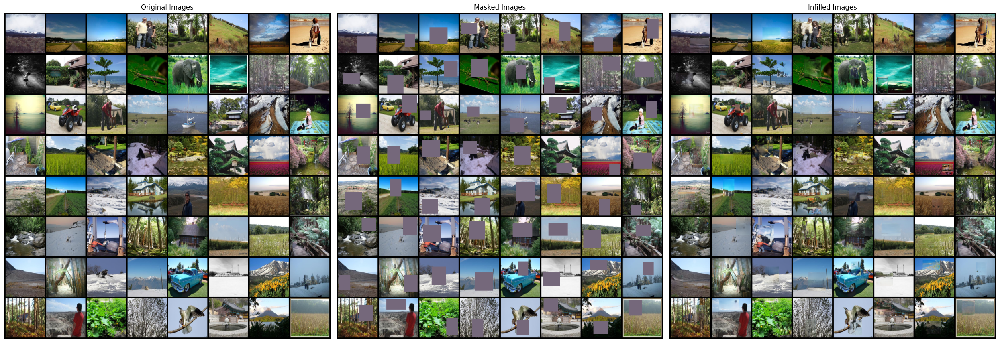

In [20]:
# Example of how to visualize the results
def visualize_results(test_batch, masked_samples, infilled_images, num_images=64):
    plt.figure(figsize=(25, 25))
    
    # Plot original images
    plt.subplot(1, 3, 1)
    plt.axis("off")
    plt.title("Original Images")
    plt.imshow(np.transpose(vutils.make_grid(test_batch[:num_images].cpu(), padding=5, normalize=True), (1, 2, 0)))
    
    # Plot masked images
    plt.subplot(1, 3, 2)
    plt.axis("off")
    plt.title("Masked Images")
    plt.imshow(np.transpose(vutils.make_grid(masked_samples[:num_images].cpu(), padding=5, normalize=True), (1, 2, 0)))
    
    # Plot infilled images
    plt.subplot(1, 3, 3)
    plt.axis("off")
    plt.title("Infilled Images")
    plt.imshow(np.transpose(vutils.make_grid(infilled_images[:num_images].cpu(), padding=5, normalize=True), (1, 2, 0)))
    
    plt.tight_layout()
    plt.show()

# Uncomment to visualize the results
visualize_results(test_batch, masked_samples, infilled_images)

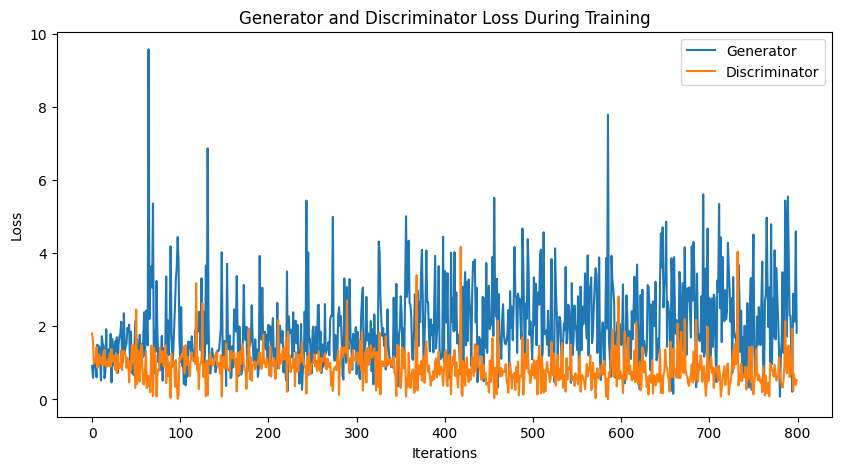

In [21]:
# Plot training losses
def plot_losses(G_losses, D_losses):
    plt.figure(figsize=(10,5))
    plt.title("Generator and Discriminator Loss During Training")
    plt.plot(G_losses, label="Generator")
    plt.plot(D_losses, label="Discriminator")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

# Uncomment to plot losses
plot_losses(G_losses, D_losses)

Animation size has reached 21379186 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


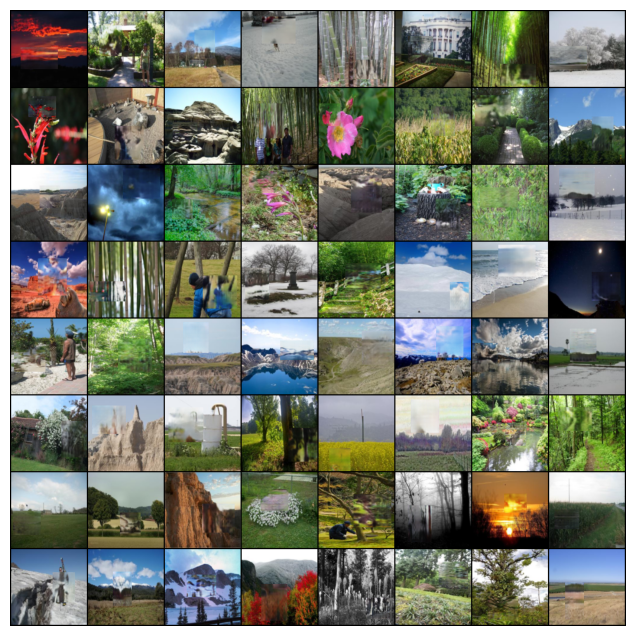

In [22]:
# Create animation of training progress
def create_training_animation(img_list):
    fig = plt.figure(figsize=(8,8))
    plt.axis("off")
    ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated=True)] for i in img_list]
    ani = animation.ArtistAnimation(fig, ims, interval=200, repeat_delay=1000, blit=True)
    return HTML(ani.to_jshtml())

# Uncomment to create animation
create_training_animation(img_list)

In [19]:
import torch
import numpy as np
from scipy.linalg import sqrtm
from torchvision.models import inception_v3, Inception_V3_Weights
import torch.nn.functional as F
import gc

# Global inception model to avoid reloading
_inception_model = None

def get_inception_model(device):
    global _inception_model
    if _inception_model is None:
        print("Loading InceptionV3 model...")
        weights = Inception_V3_Weights.DEFAULT
        _inception_model = inception_v3(weights=weights, transform_input=False)
        _inception_model.fc = torch.nn.Identity()
        _inception_model = _inception_model.to(device)
        _inception_model.eval()
        print("InceptionV3 loaded.")
    return _inception_model

# Optimized metrics with smaller batch processing
def compute_psnr_fast(img1, img2, max_pixel=1.0):
    img1 = (img1 + 1) / 2 if img1.min() < 0 else img1
    img2 = (img2 + 1) / 2 if img2.min() < 0 else img2
    mse = torch.mean((img1 - img2) ** 2, dim=[1,2,3])
    psnr = 10 * torch.log10(max_pixel ** 2 / (mse + 1e-8))
    return psnr.mean().item()

def compute_mae_fast(img1, img2):
    img1 = (img1 + 1) / 2 if img1.min() < 0 else img1
    img2 = (img2 + 1) / 2 if img2.min() < 0 else img2
    mae = torch.mean(torch.abs(img1 - img2), dim=[1,2,3])
    return mae.mean().item()

def compute_rmse_fast(img1, img2):
    img1 = (img1 + 1) / 2 if img1.min() < 0 else img1
    img2 = (img2 + 1) / 2 if img2.min() < 0 else img2
    mse = torch.mean((img1 - img2) ** 2, dim=[1,2,3])
    rmse = torch.sqrt(mse)
    return rmse.mean().item()

def compute_ssim_fast(img1, img2, C1=0.01**2, C2=0.03**2):
    img1 = (img1 + 1) / 2 if img1.min() < 0 else img1
    img2 = (img2 + 1) / 2 if img2.min() < 0 else img2

    # Compute mean
    mu1 = torch.mean(img1, dim=[2,3], keepdim=True)
    mu2 = torch.mean(img2, dim=[2,3], keepdim=True)
    
    # Compute variance and covariance
    sigma1_sq = torch.mean((img1 - mu1) ** 2, dim=[2,3], keepdim=True)
    sigma2_sq = torch.mean((img2 - mu2) ** 2, dim=[2,3], keepdim=True)
    sigma12 = torch.mean((img1 - mu1) * (img2 - mu2), dim=[2,3], keepdim=True)

    ssim_map = ((2 * mu1 * mu2 + C1) * (2 * sigma12 + C2)) / \
               ((mu1 ** 2 + mu2 ** 2 + C1) * (sigma1_sq + sigma2_sq + C2))
    return ssim_map.mean().item()

def get_inception_features_optimized(images, device, batch_size=8):
    """Optimized inception features with smaller batches and memory management"""
    inception_model = get_inception_model(device)
    
    if images.min() < 0:
        images = (images + 1) / 2
    
    # Process in smaller chunks to save memory
    feats = []
    with torch.no_grad():
        for i in range(0, images.size(0), batch_size):
            batch = images[i:i+batch_size]
            # Resize to 299x299 for InceptionV3
            batch_resized = F.interpolate(batch, size=(299, 299), mode="bilinear", align_corners=False)
            batch_resized = batch_resized.to(device)
            
            # Get features
            pred = inception_model(batch_resized)
            feats.append(pred.cpu().numpy())
            
            # Clear GPU memory
            del batch_resized
            torch.cuda.empty_cache() if torch.cuda.is_available() else None
            
    return np.concatenate(feats, axis=0)

def compute_fid_optimized(real_imgs, fake_imgs, device, batch_size=8):
    """Memory-optimized FID computation"""
    try:
        print(f"Computing FID with batch_size={batch_size}...")
        
        # Get features with smaller batches
        feats_real = get_inception_features_optimized(real_imgs, device, batch_size)
        feats_fake = get_inception_features_optimized(fake_imgs, device, batch_size)
        
        # Compute statistics
        m1, m2 = feats_real.mean(axis=0), feats_fake.mean(axis=0)
        
        # For large datasets, compute covariance in chunks to save memory
        if feats_real.shape[0] > 100:
            # Use a more memory-efficient covariance calculation
            c1 = np.cov(feats_real.T)
            c2 = np.cov(feats_fake.T)
        else:
            c1 = np.cov(feats_real, rowvar=False)
            c2 = np.cov(feats_fake, rowvar=False)
        
        # Compute FID
        ssdiff = np.sum((m1 - m2) ** 2)
        covmean = sqrtm(c1.dot(c2))
        
        if np.iscomplexobj(covmean):
            covmean = covmean.real
            
        fid = ssdiff + np.trace(c1 + c2 - 2.0 * covmean)
        
        # Clean up
        del feats_real, feats_fake, c1, c2
        gc.collect()
        
        return float(fid)
        
    except Exception as e:
        print(f"FID computation failed: {e}")
        return 999.0  # Return high FID score on failure

# Lightweight evaluation function
def evaluate_images_optimized(recon_images, gt_images, compute_fid=True, fid_batch_size=8):
    """
    Optimized evaluation with memory management
    Set compute_fid=False to skip FID if too slow
    """
    print("Computing evaluation metrics...")
    
    # Limit batch size for memory efficiency
    max_samples = min(64, recon_images.size(0))  # Limit to 64 samples max
    recon_images = recon_images[:max_samples]
    gt_images = gt_images[:max_samples]
    
    # Fast metrics
    psnr = compute_psnr_fast(recon_images, gt_images)
    mae = compute_mae_fast(recon_images, gt_images)
    rmse = compute_rmse_fast(recon_images, gt_images)
    ssim = compute_ssim_fast(recon_images, gt_images)
    
    # Simple LPIPS-like metric
    lpips_like = torch.mean((recon_images - gt_images) ** 2).item()
    
    results = {
        "PSNR": psnr,
        "MAE": mae,
        "RMSE": rmse,
        "SSIM": ssim,
        "LPIPS-like": lpips_like,
    }
    
    # Optional FID computation
    if compute_fid:
        device = recon_images.device
        fid = compute_fid_optimized(gt_images, recon_images, device, fid_batch_size)
        results["FID"] = fid
    else:
        results["FID"] = "Not computed"
        
    return results

# Quick evaluation without FID
def evaluate_images_quick(recon_images, gt_images):
    """Quick evaluation without FID - much faster"""
    return evaluate_images_optimized(recon_images, gt_images, compute_fid=False)

# Test with your data
if __name__ == "__main__":
    print("Running optimized evaluation...")
    test_batch, masked_samples, infilled_images, mask_info = test_model(netG)
    
    # Quick evaluation (no FID)
    print("\nQuick metrics (no FID):")
    quick_metrics = evaluate_images_quick(infilled_images, test_batch)
    print(quick_metrics)
    
    # Full evaluation with optimized FID
    print("\nFull metrics (with optimized FID):")
    full_metrics = evaluate_images_optimized(infilled_images, test_batch, 
                                           compute_fid=True, fid_batch_size=4)
    print(full_metrics)

Running optimized evaluation...

Quick metrics (no FID):
Computing evaluation metrics...
{'PSNR': 26.139890670776367, 'MAE': 0.015355143696069717, 'RMSE': 0.05358882248401642, 'SSIM': 0.9559739828109741, 'LPIPS-like': 0.013134032487869263, 'FID': 'Not computed'}

Full metrics (with optimized FID):
Computing evaluation metrics...
Computing FID with batch_size=4...
Loading InceptionV3 model...
Downloading: "https://download.pytorch.org/models/inception_v3_google-0cc3c7bd.pth" to C:\Users\Admin/.cache\torch\hub\checkpoints\inception_v3_google-0cc3c7bd.pth


100.0%


InceptionV3 loaded.
{'PSNR': 26.139890670776367, 'MAE': 0.015355143696069717, 'RMSE': 0.05358882248401642, 'SSIM': 0.9559739828109741, 'LPIPS-like': 0.013134032487869263, 'FID': 50.78541846874184}


Image tensor shape: torch.Size([1, 3, 128, 128])


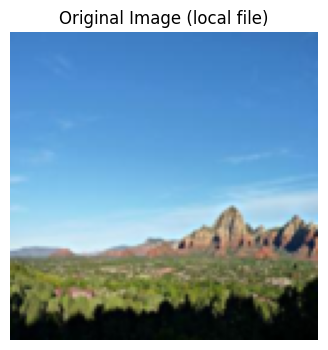

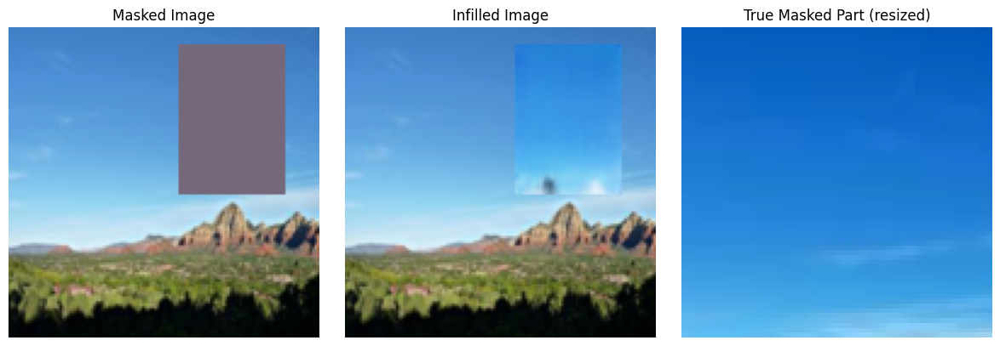

(tensor([[[[-0.5059, -0.4980, -0.4902,  ..., -0.5137, -0.5373, -0.5608],
           [-0.4980, -0.4902, -0.4902,  ..., -0.5294, -0.5451, -0.5686],
           [-0.4902, -0.4902, -0.4824,  ..., -0.5451, -0.5608, -0.5765],
           ...,
           [-1.0000, -0.9922, -0.9765,  ..., -0.9843, -0.9843, -0.9843],
           [-1.0000, -1.0000, -0.9765,  ..., -0.9922, -0.9922, -0.9922],
           [-1.0000, -1.0000, -0.9843,  ..., -1.0000, -1.0000, -0.9922]],
 
          [[-0.0118, -0.0039,  0.0039,  ..., -0.0431, -0.0667, -0.0902],
           [-0.0039,  0.0039,  0.0039,  ..., -0.0667, -0.0824, -0.1059],
           [ 0.0039,  0.0039,  0.0118,  ..., -0.0824, -0.0980, -0.1137],
           ...,
           [-0.9608, -0.9451, -0.9373,  ..., -0.9686, -0.9686, -0.9686],
           [-0.9529, -0.9451, -0.9373,  ..., -0.9765, -0.9765, -0.9765],
           [-0.9451, -0.9451, -0.9451,  ..., -0.9922, -0.9843, -0.9765]],
 
          [[ 0.5451,  0.5529,  0.5608,  ...,  0.4588,  0.4353,  0.4118],
           [ 

In [20]:
import PIL
import torch
import torchvision.transforms as transforms
import torchvision.utils as vutils
import matplotlib.pyplot as plt
import torch.nn.functional as F

def test_custom_image_local(netG, device, image_path, image_size=128):
    """
    Đọc ảnh từ đường dẫn cục bộ, resize, mask, infill và hiển thị kết quả.
    """
    # 1. Đọc ảnh từ file local
    im = PIL.Image.open(image_path).convert('RGB')

    # 2. Transform
    transform = transforms.Compose([
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ])
    im_tensor = transform(im)
    if im_tensor.shape[0] != 3:
        im_tensor = im_tensor[0:3, :, :]
    im_tensor = im_tensor.unsqueeze(0).to(device)
    print("Image tensor shape:", im_tensor.shape)

    # 3. Hiển thị ảnh gốc
    plt.figure(figsize=(4,4))
    plt.axis("off")
    plt.title("Original Image (local file)")
    plt.imshow(np.transpose(vutils.make_grid(im_tensor.cpu(), padding=2, normalize=True), (1,2,0)))
    plt.show()

    # 4. Tạo mask ngẫu nhiên
    test_masked_samples, test_true_masked_part, mask_info = get_random_block_mask(im_tensor)

    # 5. Infill với netG
    netG.eval()
    with torch.no_grad():
        fake = netG(test_masked_samples).detach().cpu()
        viz_infill = test_masked_samples.clone().cpu()
        for idx, (top, left, mask_h, mask_w) in enumerate(mask_info):
            if idx < fake.size(0):
                resized_fake = F.interpolate(
                    fake[idx].unsqueeze(0), 
                    size=(mask_h, mask_w), 
                    mode='bilinear', 
                    align_corners=False
                )
                viz_infill[idx, :, top:top+mask_h, left:left+mask_w] = resized_fake.squeeze(0)

    # 6. Hiển thị kết quả
    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1)
    plt.axis("off")
    plt.title("Masked Image")
    plt.imshow(np.transpose(vutils.make_grid(test_masked_samples.cpu(), padding=2, normalize=True), (1,2,0)))

    plt.subplot(1,3,2)
    plt.axis("off")
    plt.title("Infilled Image")
    plt.imshow(np.transpose(vutils.make_grid(viz_infill.cpu(), padding=2, normalize=True), (1,2,0)))

    plt.subplot(1,3,3)
    plt.axis("off")
    plt.title("True Masked Part (resized)")
    plt.imshow(np.transpose(vutils.make_grid(test_true_masked_part.cpu(), padding=2, normalize=True), (1,2,0)))
    plt.tight_layout()
    plt.show()

    return im_tensor, test_masked_samples, viz_infill, test_true_masked_part

image_path = "Data/image_examples/test.jpg"
test_custom_image_local(netG, device, image_path)